# Homework 9

# Import all tools 




In [0]:
import pandas as pd
import numpy as np
import pylab as plt
import seaborn as sns
import sklearn as sklearn
import pickle
import itertools

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix

import keras
from keras import Model
from keras.models import Sequential
from keras.layers import Dense, Dropout

import warnings
warnings.filterwarnings('ignore')


# Mount gdrive and navigate to desired folder



In [70]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
cd gdrive


/content/gdrive


In [4]:
cd My\ Drive


/content/gdrive/My Drive


In [71]:
cd HW5/

[Errno 2] No such file or directory: 'HW5/'
/content/gdrive/My Drive/HW5


# Acquire data:

Data was utilized from the PLAstiCC challenge that we utilized in previous homeworks. Data can be downloaded from Kaggle --- https://www.kaggle.com/c/PLAsTiCC-2018 or from zenodo --- https://zenodo.org/record/2539456#.XonrIdNKjOQ 

In [72]:
#only part of the dataset was utilized because my model would crash when I ran the full dataset
lcvs = pd.read_csv('training_set.csv')
lcvs = lcvs[:375000]
print("The dataset contains: (observations, columns)", lcvs.shape)


The dataset contains: (observations, columns) (375000, 6)


# Check data structure with visualization

In [73]:
lcvs.head()

,object_id,mjd,passband,flux,flux_err,detected
0,615,59750.4229,2,-544.810303,3.622952,1
1,615,59750.4306,1,-816.434326,5.553370,1
2,615,59750.4383,3,-471.385529,3.801213,1
3,615,59750.4450,4,-388.984985,11.395031,1
4,615,59752.4070,2,-681.858887,4.041204,1


In [74]:
bands = lcvs["passband"].unique()
print("Passbands (filter) identifiers:", bands)

Passbands (filter) identifiers: [2 1 3 4 5 0]


In [75]:
objects = lcvs["object_id"].unique()
print("There are {} astrophysical simulated objects in my dataset".format(objects.shape[0]))

There are 1150 astrophysical simulated objects in my dataset


# Choosing a common time frame and interpolating the time series

This data presents a challenge in that it is not evenly sampled. In order to run a nueral network and later classify, all inputs must occur at the same time and be sampled in the same frequency. Gaussian processing is a way to transform the data such that the data will be transformed into an evenly sampled estimate of the time series. It generates a smooth data curve by estimating unknown datapoints and their uncertainty. 

I chose to organize the data such that each object will be predicted within each of its passbands. This (hopefully) will create a NN model that can accurately predict not only the object time series, but the time series within each pass band. This organization will allow more data to be incorporated into the model (instead of collpasing across bands).



In [0]:
#the below function standardizes the data, fits the data, and takes even samples from the data.

def gp(mjd, flux):
    mjdstandardize = (mjd - mjd.mean()) / mjd.std()
    fluxstandardize = (flux - flux.mean()) / flux.std()
    kernel = RBF(10, (1e-2, 1e2))
    gpreg = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=100, alpha=.3)
    gpreg.fit(mjdstandardize.reshape(-1, 1), fluxstandardize)
    mjd_even_standardize = np.linspace((0 - mjd.mean()) / mjd.std(), (900 - mjd.mean()) / mjd.std())
    flux_even_standardize, sigma = gpreg.predict(mjd_even_standardize.reshape(-1, 1), return_std=True)
    return mjd_even_standardize, flux_even_standardize

In [0]:
#create matrices
mjds = []
fluxs = []
object_ids = []
passbands = []

In [0]:
#fit each object 
# mjd = mjd - mjd[0]  sets the initial time to 0 which takes care of the second 
#challenge in the homework (choosing a common time frame for all observations)
#This function also takes care of challenge three, interpolating the time series using GP

for i, obj in enumerate(list(lcvs.object_id.unique())):
    print('Fitting object {0}/{1}'.format(i+1, len(lcvs.object_id.unique())))
    for j in range(6):
        mjd = lcvs[lcvs.object_id == obj][lcvs.passband == j]['mjd'].to_numpy()
        mjd = mjd - mjd[0]  
        flux = lcvs[lcvs.object_id == obj][lcvs.passband == j]['flux'].to_numpy()
        detected = lcvs[lcvs.object_id == obj][lcvs.passband == j]['detected'].to_numpy()
        mjd_even_standardize, flux_even_standardize = gp(mjd, flux)        
        mjds.append(mjd_even_standardize)
        fluxs.append(flux_even_standardize)
        object_ids.append(np.ones(len(mjd_even_standardize)) * obj)
        passbands.append(np.ones(len(mjd_even_standardize)) * j)


Fitting object 1/1150
Fitting object 2/1150
Fitting object 3/1150
Fitting object 4/1150
Fitting object 5/1150
Fitting object 6/1150
Fitting object 7/1150
Fitting object 8/1150
Fitting object 9/1150
Fitting object 10/1150
Fitting object 11/1150
Fitting object 12/1150
Fitting object 13/1150
Fitting object 14/1150
Fitting object 15/1150
Fitting object 16/1150
Fitting object 17/1150
Fitting object 18/1150
Fitting object 19/1150
Fitting object 20/1150
Fitting object 21/1150
Fitting object 22/1150
Fitting object 23/1150
Fitting object 24/1150
Fitting object 25/1150
Fitting object 26/1150
Fitting object 27/1150
Fitting object 28/1150
Fitting object 29/1150
Fitting object 30/1150
Fitting object 31/1150
Fitting object 32/1150
Fitting object 33/1150
Fitting object 34/1150
Fitting object 35/1150
Fitting object 36/1150
Fitting object 37/1150
Fitting object 38/1150
Fitting object 39/1150
Fitting object 40/1150
Fitting object 41/1150
Fitting object 42/1150
Fitting object 43/1150
Fitting object 44/11

# SAVE ALL DATA



In [10]:
#SAVE ALL DATA
mjds = np.array(mjds)
fluxs = np.array(fluxs)
passbands = np.array(passbands)
object_ids = np.array(object_ids)

np.save('mjds.npy', mjds)
np.save('fluxs.npy', fluxs)
np.save('passbands.npy', passbands)
np.save('object_ids.npy', object_ids)


NameError: ignored

# Load data from previous session, check data shapes, and transform it so it is ready to be seperated into training and test sets

In [0]:

mjds = np.load('mjds.npy')
fluxs = np.load('fluxs.npy')
passbands = np.load('passbands.npy')
object_ids = np.load('object_ids.npy')

In [78]:
mjds.shape


(6900, 50)

In [0]:
object_ids_adj = object_ids.reshape(object_ids.shape[0] // 6, object_ids.shape[1] * 6).astype(int)
mjds_adj = mjds.reshape(mjds.shape[0] // 6, mjds.shape[1] * 6)
fluxs_adj = fluxs.reshape(fluxs.shape[0] // 6, fluxs.shape[1] * 6)
passbands_adj = passbands.reshape(passbands.shape[0] // 6, passbands.shape[1] * 6)

In [0]:
gpdata = pd.DataFrame(fluxs_adj, index=object_ids_adj[:, 0])
gp_data.to_csv('gpdata.csv')

In [81]:
gpdata = pd.read_csv('gpdata.csv', index_col=0)
gpdata.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
615,0.291382,-0.000005,-0.133199,-1.021835,0.000050,5.462512e-28,2.289755e-70,3.904597e-132,2.720645e-213,7.748889e-314,0.000000e+00,-2.328870e-272,-1.997187e-179,-7.001321e-106,-1.003295e-51,-5.877132e-17,-1.407310e-01,-7.579096e-03,1.761645e-01,-0.000705,-0.002614,-0.370116,5.925538e-02,-9.064958e-03,1.282418,-1.423484e-06,-2.475999e-31,-1.687587e-75,-4.690395e-139,-5.327855e-222,0.000000e+00,0.000000e+00,1.130764e-245,6.780128e-158,1.662108e-89,1.668508e-40,6.974726e-11,1.016742e+00,1.707259e-02,9.719586e-04,...,-1.302013e-54,-2.110400e-102,-2.888135e-165,-3.337131e-243,-1.106103e-294,-4.386843e-208,-1.468966e-136,-4.153121e-80,-9.913810e-39,-1.998066e-12,-0.340002,-0.000042,0.480672,-0.063395,1.043370,0.999031,-0.203810,0.839031,9.366403e-08,8.779186e-30,6.947665e-67,4.642229e-119,2.618891e-186,1.247416e-268,-5.004609e-288,-1.588679e-202,-4.257994e-132,-9.635566e-77,-1.840999e-36,-2.971706e-11,-0.474959,0.735289,0.015454,-0.257292,0.066436,1.039704,-0.603251,0.097073,0.000666,1.104793e-19
713,0.954059,0.985041,1.012317,1.038178,1.065156,1.095680e+00,1.131689e+00,1.174256e+00,1.223262e+00,1.277176e+00,1.332985e+00,1.386294e+00,1.431602e+00,1.462746e+00,1.473469e+00,1.458049e+00,1.411932e+00,1.332288e+00,1.218414e+00,1.071949,0.896854,0.699161,4.865073e-01,2.675150e-01,0.051074,-1.543912e-01,-3.415895e-01,-5.049012e-01,-6.407322e-01,-7.476569e-01,-8.263458e-01,-8.793015e-01,-9.104405e-01,-9.245789e-01,-9.268813e-01,-9.223324e-01,-9.152846e-01,-9.091184e-01,-9.060393e-01,-9.070170e-01,...,-7.696784e-05,-1.982138e-07,-1.064506e-10,-1.209474e-14,5.742295e-13,2.703101e-09,2.798178e-06,6.371292e-04,3.165708e-02,3.280151e-01,0.645332,0.846215,0.805039,-1.264264,-1.273094,0.118193,0.173605,0.233807,3.814507e-02,9.628576e-04,4.539860e-06,4.299320e-09,8.446149e-13,3.435713e-17,-2.384811e-14,-1.946910e-10,-3.431149e-07,-1.300160e-04,-1.055885e-02,-1.867992e-01,-0.809148,-1.152781,-0.679318,-0.579019,-0.401403,-1.057943,-0.937631,-0.317195,-0.026399,-4.609722e-04
730,-0.292646,-0.000255,-0.288472,-0.299162,0.000044,-1.617656e-01,2.532819e-01,8.559876e-02,3.842090e-15,1.835840e-43,1.508982e-86,2.244031e-144,6.083645e-217,3.010262e-304,1.424323e-222,5.271353e-149,3.557761e-90,4.354575e-46,9.321608e-17,0.025872,-0.038564,-0.664620,-1.756516e-09,-4.011977e-10,0.786220,-4.391976e-05,5.696952e-01,5.043681e-10,2.182321e-33,1.285571e-71,1.318762e-124,2.451465e-192,8.309627e-275,0.000000e+00,2.988919e-273,3.793985e-191,8.828137e-124,3.843657e-71,3.503873e-33,1.012888e-09,...,-1.842823e-01,-1.590420e-01,-1.560527e-01,-1.916119e-01,-2.742348e-01,-3.996081e-01,-5.466615e-01,-6.793370e-01,-7.580849e-01,-7.588694e-01,-0.689089,-0.587524,-0.504458,-0.473298,-0.492989,-0.532904,-0.554678,-0.533966,-4.683661e-01,-3.702329e-01,-2.527070e-01,-1.179132e-01,4.840396e-02,2.749968e-01,5.953852e-01,1.029845e+00,1.562514e+00,2.124072e+00,2.594896e+00,2.838207e+00,2.755769,2.339610,1.687647,0.968426,0.351446,-0.058114,-0.245678,-0.267358,-0.204871,-1.253681e-01
745,-0.105521,-0.214751,-0.317985,-0.388530,-0.408590,-3.757044e-01,-3.010467e-01,-2.003616e-01,-8.215094e-02,6.131154e-02,2.557119e-01,5.364666e-01,9.300449e-01,1.428804e+00,1.970330e+00,2.437404e+00,2.690154e+00,2.624324e+00,2.227816e+00,1.599802,0.914507,0.346429,-5.248239e-04,-1.213317e-01,-0.086787,7.991104e-03,8.962651e-02,1.260027e-01,1.197078e-01,8.957006e-02,5.458180e-02,2.646507e-02,9.296131e-03,1.518508e-03,-2.973053e-03,-1.484370e-02,-4.821139e-02,-1.161796e-01,-2.232905e-01,-3.586862e-01,...,-2.622482e-01,-8.174294e-02,1.762935e-01,5.492343e-01,1.073399e+00,1.751126e+00,2.516264e+00,3.223259e+00,3.681161e+00,3.729852e+00,3.322741,2.564152,1.670874,0.875833,0.330956,0.063922,0.003071,0.040707,9.012100e-02,1.094285e-01,9.38

# Create a train and test set. 
I chose to test with 20% of the data and to train with 80% of the data. The random state used throughout the data is 32.

In [0]:
X_train, X_test, y_train, y_test = train_test_split(gpdata, gpdata, test_size=0.2, random_state=32)

In [83]:
X_train.shape

(920, 300)

# Create the Autoencoder
Following the exercises in class, I decided to make a symmetric model starting with a 300 input dimension. This came from the X_train shape (50 flux values x 6 pass bands). This network trains down to 50 neurons, reducing the dimensionality of the inputs by 6. I chose this value after a literature search and trial and error. Many conceptual nerual network models begin with 5 or 6 inputs and have a bottleneck of 1 neuron. Training a model with a 50 neuron bottleneck was also more efficient than training a model with a smaller bottleneck (e.g., 25 or 10 neurons, both took hours longer to run with marginal accuracy differences). Mean square error (MSE) was used for the loss function because this is a regression problem where a quantity is being predicted from a neural network. This begins to satisfy challenge four in the homework assignment: create an autoencoder where the middle layer is smaller than the original size of the time series.

In [0]:
def create_model(input_dim=300):
  model = Sequential()
  model.add(Dense(300, activation='relu', input_dim=300))
  model.add(Dense(150, activation='relu'))
  model.add(Dense(50, activation='relu'))
  model.add(Dense(150, activation='relu'))
  model.add(Dense(300, activation='relu'))
  model.compile(optimizer='adamax', loss='mse', metrics=['mae', 'acc'])
  return model
model = create_model()


In [85]:
print(model.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 300)               90300     
_________________________________________________________________
dense_7 (Dense)              (None, 150)               45150     
_________________________________________________________________
dense_8 (Dense)              (None, 50)                7550      
_________________________________________________________________
dense_9 (Dense)              (None, 150)               7650      
_________________________________________________________________
dense_10 (Dense)             (None, 300)               45300     
Total params: 195,950
Trainable params: 195,950
Non-trainable params: 0
_________________________________________________________________
None


In [86]:
history = model.fit(X_train.values, y_train.values, epochs=10000, batch_size=32, verbose=1)
model.save("hw9model10000.h5")

Streaming output truncated to the last 5000 lines.
920/920 [==============================] - 0s 112us/step - loss: 0.1470 - mae: 0.1906 - acc: 0.7587
Epoch 7502/10000
920/920 [==============================] - 0s 110us/step - loss: 0.1470 - mae: 0.1907 - acc: 0.7641
Epoch 7503/10000
920/920 [==============================] - 0s 114us/step - loss: 0.1471 - mae: 0.1908 - acc: 0.7696
Epoch 7504/10000
920/920 [==============================] - 0s 108us/step - loss: 0.1470 - mae: 0.1906 - acc: 0.7641
Epoch 7505/10000
920/920 [==============================] - 0s 117us/step - loss: 0.1470 - mae: 0.1906 - acc: 0.7576
Epoch 7506/10000
920/920 [==============================] - 0s 117us/step - loss: 0.1470 - mae: 0.1906 - acc: 0.7598
Epoch 7507/10000
920/920 [==============================] - 0s 113us/step - loss: 0.1470 - mae: 0.1906 - acc: 0.7576
Epoch 7508/10000
920/920 [==============================] - 0s 111us/step - loss: 0.1470 - mae: 0.1905 - acc: 0.7587
Epoch 7509/10000
920/920 [====

# Load model from pervious session

In [0]:
model = keras.models.load_model('hw9model10000.h5')

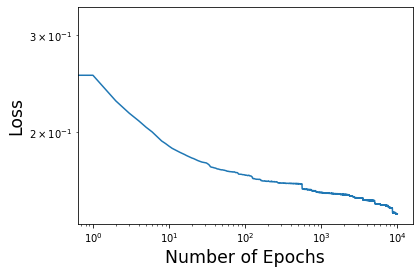

In [87]:

mjds = np.load('mjds.npy')
fluxs = np.load('fluxs.npy')
passbands = np.load('passbands.npy')
object_ids = np.load('object_ids.npy')
plt.plot(np.array(history.history['loss']))
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Number of Epochs', fontsize='xx-large')
plt.ylabel('Loss', fontsize='xx-large');

Figure: This figure demonstrates the loss function of the neural network. Becuase of the flat line observed towards the end of the X axis, one can see that this model starts to reach equilibrium (it did not finish learning because it is still decreasing). Running this a few times I found that 10,000 epochs got the closest to equilibrium. Epoch numbers of 1,000 and 5,000 did not have as flat of a curve at the end. This suggests the present model needs many more epochs to train. However, considering only a portion of the dataset was used, having a larger training dataset may make training fewer epochs more feasible. This graph also sheds light on whether or not mean square error (MSE) was a wise choice for the loss function. Choosing an alternative loss function like maximum liklihood may have produced a more accurate model.  

In [0]:
y_pred = model.predict(X_test)

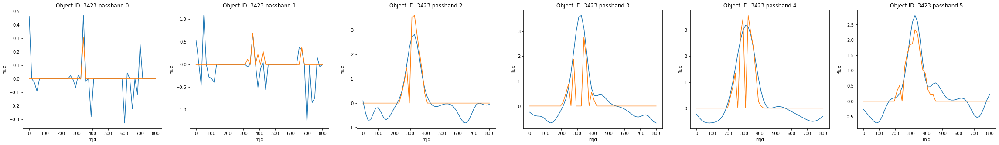

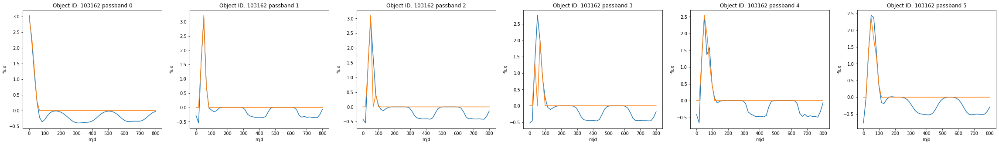

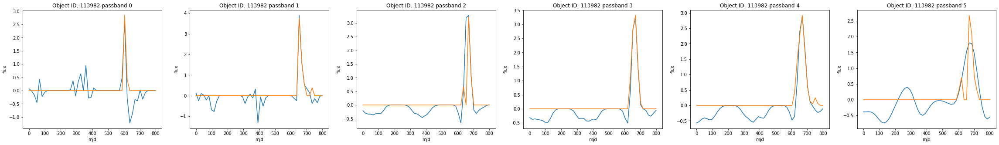

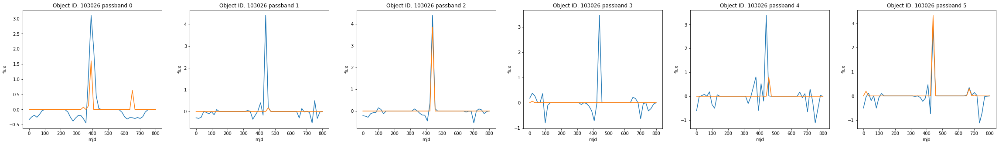

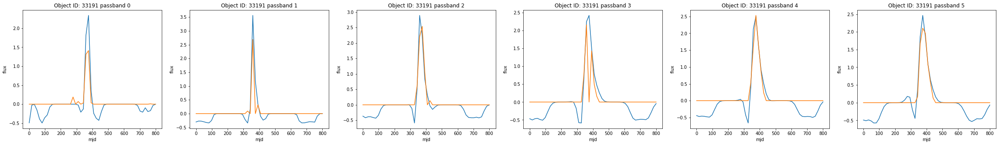

...

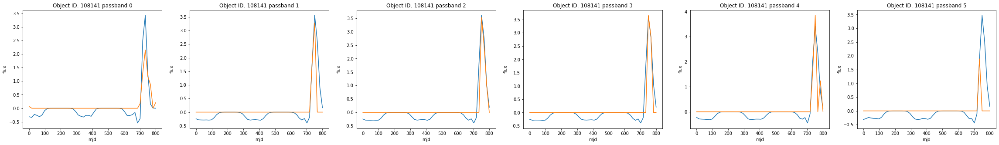

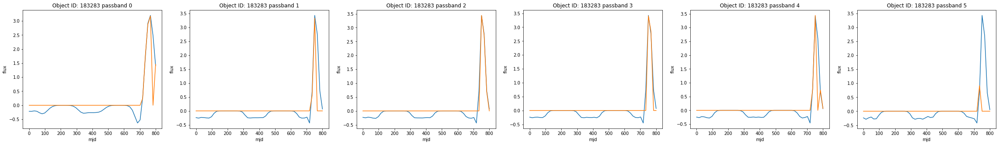

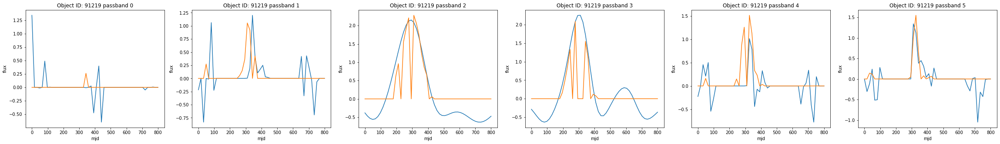

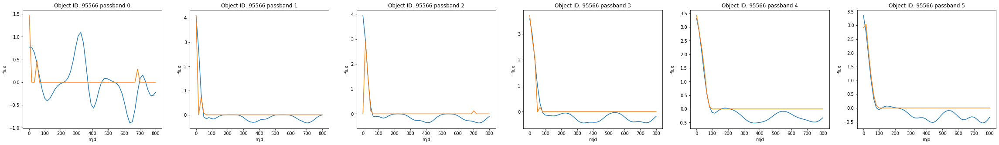

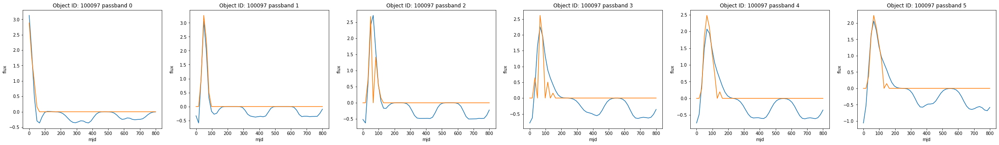

In [0]:
for i in range(len(X_test)):
    fig, ax = plt.subplots(1, 6, figsize=(40, 5))
    for p in range(6):
        test_mjds = np.linspace(0, 800)
        orig = X_test.values[i].reshape(6, 50)
        pred = y_pred[i].reshape(6, 50)

        ax[p].plot(test_mjds, orig[p], label='original series')
        ax[p].plot(test_mjds, pred[p], label='re-created series')

        ax[p].set_title('Object ID: {0} passband {1}'.format(X_test.index[i], p))
        ax[p].set_ylabel('flux')
        ax[p].set_xlabel('mjd')
    fig.show();

Figure: The original light curves are plotted in blue while the modeled light curves are plotted in orange. The orange lines were created by the autoencoder. Each passband for each object was plotted independently. Observing all the plots, some autoencoder lines fit the data much better than others. For example, the data trend object 37865 passband 2 matches the trend of the true data while the data trend of Object 118455 passband 0 does not capture the variability in the real data. By utilizing more data to train the model, or by increasing epochs, we may be able to get a better model prediction.

# Create new features from the autoencoder



In [89]:

# Create encoder to extract the bottleneck features from the model
encoderforbot = Model(model.input, model.layers[-3].output)
encoderforbot_predict = encoderforbot.predict(fluxs_adj)
encoderforbot_predict.shape

(1150, 50)

In [90]:
#extract features and check data with head and tail
encoder_features = pd.DataFrame(encoderforbot_predict, columns=['enc{0}'.format(i) for i in range(encoderforbot_predict.shape[1])])
encoder_features.head()


,enc0,enc1,enc2,enc3,enc4,enc5,enc6,enc7,enc8,enc9,enc10,enc11,enc12,enc13,enc14,enc15,enc16,enc17,enc18,enc19,enc20,enc21,enc22,enc23,enc24,enc25,enc26,enc27,enc28,enc29,enc30,enc31,enc32,enc33,enc34,enc35,enc36,enc37,enc38,enc39,enc40,enc41,enc42,enc43,enc44,enc45,enc46,enc47,enc48,enc49
0,1.221003,2.413638,0.971586,2.010588,1.614938,0.831052,0.000000,0.101732,1.053775,0.000000,0.000000,1.876154,1.471478,2.490366,1.010129,1.429958,1.725940,0.709059,0.822660,1.787171,0.00000,0.0,1.038435,0.770611,0.000000,0.001368,0.705588,0.000000,0.450219,2.584270,2.134170,0.0,1.976442,0.000000,1.170281,0.123173,1.494734,0.595784,0.000000,0.000000,0.811341,2.87828,0.000000,1.283550,1.700575,0.761165,2.611950,0.0,2.632218,1.564955
1,0.000000,2.772754,0.199611,1.063684,1.442995,0.000000,0.298181,0.313685,0.000000,2.707724,0.216470,0.604560,0.000000,0.009224,0.350685,0.000000,1.910052,0.160696,0.000000,0.291661,1.34453,0.0,0.322027,0.000000,0.341682,2.950358,2.069182,0.444592,0.000000,0.000000,0.605897,0.0,0.000000,1.582206,0.678260,0.000000,2.741234,0.000000,1.529436,1.731256,0.000000,0.00000,0.181977,1.725581,0.671366,0.449460,0.337516,0.0,1.158020,0.895135
2,3.993995,1.055379,0.949604,1.017112,0.000000,2.355650,2.195879,0.000000,0.950232,0.000000,1.967505,1.223188,4.368092,0.614001,0.715738,2.045254,0.000000,1.232994,1.571184,2.966614,0.00000,0.0,0.924054,0.488611,0.000000,1.438193,0.579615,0.000000,3.415771,0.234101,0.556295,0.0,1.381760,1.075312,0.555077,4.392566,0.000000,0.550508,0.506660,0.554450,0.000000,0.00000,0.000000,0.342485,0.670821,0.000000,1.520920,0.0,2.169130,0.000000
3,0.000000,4.383948,0.000000,2.128469,0.000000,0.000000,1.266682,0.000000,1.579737,2.697337,4.724422,3.996268,0.000000,0.011461,1.556882,1.614427,1.166662,0.710076,0.000000,0.637635,0.00000,0.0,0.841312,6.794111,0.000000,0.926265,2.155899,1.718394,2.353045,0.000000,1.158815,0.0,1.262374,2.355996,2.518628,0.000000,2.447735,0.000000,0.000000,9.197887,0.000000,0.00000,1.220701,0.000000,0.190009,0.000000,0.567190,0.0,2.794411,3.663276
4,5.007417,0.554789,1.674232,2.460486,0.000000,2.227054,1.824866,0.000000,1.421206,1.054236,2.437707,2.028117,2.258587,2.225752,1.110697,3.817821,0.000000,0.000000,0.000000,0.485670,0.00000,0.0,4.557317,0.000000,1.897143,1.727772,0.778344,0.000000,2.792184,0.000000,0.742271,0.0,1.095955,0.244798,1.056908,5.885589,0.000000,0.000000,1.960381,0.042529,0.000000,0.00000,0.000000,0.662034,0.000000,0.000000,0.000000,0.0,3.808839,0.000000


In [91]:
encoder_features.tail()

,enc0,enc1,enc2,enc3,enc4,enc5,enc6,enc7,enc8,enc9,enc10,enc11,enc12,enc13,enc14,enc15,enc16,enc17,enc18,enc19,enc20,enc21,enc22,enc23,enc24,enc25,enc26,enc27,enc28,enc29,enc30,enc31,enc32,enc33,enc34,enc35,enc36,enc37,enc38,enc39,enc40,enc41,enc42,enc43,enc44,enc45,enc46,enc47,enc48,enc49
1145,3.246749,1.324857,2.532292,0.880639,0.000000,2.356128,1.251135,0.000000,1.640242,0.000000,0.562121,0.236045,2.355704,1.115913,0.907494,3.983152,0.000000,0.509747,0.170958,1.762949,0.034132,0.000000,2.483103,0.000000,0.942277,2.441981,0.000000,0.000000,2.466325,0.032902,0.153763,0.0,0.209601,0.363711,0.596811,2.241157,0.000000,0.0,0.875573,0.000000,0.000000,0.000000,0.000000,1.931950,0.829948,0.446850,0.117933,0.0,1.531110,0.000000
1146,0.000000,1.633686,0.452283,4.684731,0.000000,0.061859,2.031071,1.702469,0.961238,0.000000,4.731763,0.171044,1.681762,3.410352,1.536143,2.096592,0.000000,0.000000,0.000000,0.128558,0.873332,1.558236,0.556462,0.327738,1.298433,0.222689,1.430199,0.458354,0.000000,3.968006,1.617543,0.0,0.951417,1.158850,0.762696,0.000000,3.225097,0.0,0.408472,0.000000,1.874665,0.732746,0.530241,0.886937,2.562272,0.802717,0.885022,0.0,7.045315,2.638657
1147,0.523158,0.778846,0.080310,0.829798,3.180205,1.128196,1.196326,0.713749,0.000000,3.571685,0.000000,0.000000,0.319986,0.000000,2.070269,0.000000,0.000000,2.174273,0.000000,1.666081,2.524096,0.000000,1.553253,1.543165,0.256455,2.911735,0.552193,0.000000,0.844527,1.015693,0.046809,0.0,0.755458,3.272563,2.120021,0.000000,0.953172,0.0,1.301941,0.000000,0.475222,0.000000,0.867844,0.000000,1.309073,1.487558,1.146387,0.0,0.971044,1.022535
1148,0.000000,1.218403,1.655702,1.558800,0.000000,0.000000,0.175245,0.000000,1.283213,0.000000,1.833180,0.951417,1.481758,2.319040,0.516190,1.178849,0.000000,0.000000,0.000000,0.000000,0.858366,0.000000,1.156225,1.149381,0.000000,0.724578,0.727398,1.121441,0.000000,1.096084,0.000000,0.0,1.355638,0.369280,0.000000,0.000000,0.979468,0.0,0.000000,0.000000,2.305607,2.393177,3.171189,0.700387,1.533978,1.808196,0.943844,0.0,5.623603,3.954827
1149,0.000000,0.316545,1.204466,0.242428,0.233602,1.012411,0.526379,0.431672,0.656374,0.960617,0.000000,0.000000,0.961888,0.974361,0.836617,0.753570,1.457981,1.334955,0.000000,0.260858,0.912477,0.677913,1.170816,0.000000,0.795638,1.123950,1.756548,1.519400,0.973372,0.650677,1.329937,0.0,0.826564,1.263387,0.494990,0.000000,1.052946,0.0,0.642474,0.961296,1.092958,1.221474,0.993177,0.426998,1.735889,0.788021,0.148729,0.0,0.642267,0.280374


In [92]:
#bring in old features and make sure it is the same length as the encoder features
allfeatures = pd.read_csv('allfeature_saved.csv', index_col=0)[:len(encoderforbot_predict)]
allfeatures.head()

,object_id,"(0, 'mean')","(0, 'std')","(0, 'm2')","(0, 'm3')","(0, 'maxs')","(0, 'mins')","(0, 'median')","(0, 'slopes')","(0, 'intercepts')","(0, 'll1')","(0, 'll2')","(0, 'll3')","(1, 'mean')","(1, 'std')","(1, 'm2')","(1, 'm3')","(1, 'maxs')","(1, 'mins')","(1, 'median')","(1, 'slopes')","(1, 'intercepts')","(1, 'll1')","(1, 'll2')","(1, 'll3')","(2, 'mean')","(2, 'std')","(2, 'm2')","(2, 'm3')","(2, 'maxs')","(2, 'mins')","(2, 'median')","(2, 'slopes')","(2, 'intercepts')","(2, 'll1')","(2, 'll2')","(2, 'll3')","(3, 'mean')","(3, 'std')","(3, 'm2')",...,"(3, 'slopes')","(3, 'intercepts')","(3, 'll1')","(3, 'll2')","(3, 'll3')","(4, 'mean')","(4, 'std')","(4, 'm2')","(4, 'm3')","(4, 'maxs')","(4, 'mins')","(4, 'median')","(4, 'slopes')","(4, 'intercepts')","(4, 'll1')","(4, 'll2')","(4, 'll3')","(5, 'mean')","(5, 'std')","(5, 'm2')","(5, 'm3')","(5, 'maxs')","(5, 'mins')","(5, 'median')","(5, 'slopes')","(5, 'intercepts')","(5, 'll1')","(5, 'll2')","(5, 'll3')",ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv,target
0,615,-3.254554,83.944735,6934.865833,6934.865833,125.182808,-116.913223,-0.080537,0.005676,-0.175947,-84.013092,-88.218652,-1.0,-385.699911,601.787302,355904.026224,355904.026224,660.626343,-1100.440063,-0.170090,0.014032,-0.399902,-80.867915,-80.869998,-1.0,-134.146566,455.121346,203564.138816,203564.138816,611.984558,-681.858887,-0.289021,0.017676,-0.503760,-80.092803,-80.109763,-1.0,-121.103501,335.425053,110570.138947,...,0.020475,-0.583524,-79.226482,-79.290039,-1.0,-55.954592,291.803449,83681.162283,83681.162283,381.953735,-422.184509,-0.163078,0.022343,-0.636786,-78.160027,-78.480261,-1.0,-47.449847,294.779522,85370.493377,85370.493377,378.188141,-422.815094,-0.129163,0.021319,-0.596932,-76.917754,-77.386461,-1.0,349.046051,-61.943836,320.796530,-51.753706,1,0.0000,0.0000,0.0000,NaN,0.017,92
1,713,-2.720398,7.113509,49.879128,49.879128,14.509829,-14.735178,-0.052914,-0.041433,1.429423,-45.801483,-49.801325,-1.0,-1.019804,5.712334,32.048070,32.048070,9.129021,-11.715749,0.080189,-0.051648,1.420320,-36.052358,-38.161170,-1.0,-0.794238,5.770738,32.706748,32.706748,10.529041,-10.067919,0.117188,-0.053887,1.481892,-34.410798,-35.611095,-1.0,-0.986966,6.450413,40.864832,...,-0.050983,1.402038,-38.701863,-41.302700,-1.0,-0.900262,6.406989,40.316483,40.316483,9.827934,-12.286801,0.016870,-0.050464,1.387765,-44.424807,-44.870314,-1.0,-1.794175,7.094073,49.427194,49.427194,14.770886,-14.211164,-0.094281,-0.037903,1.042343,-65.167686,-65.424297,-1.0,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007,88
2,730,-0.048080,1.828872,3.298318,3.298318,5.942166,-3.459960,0.039463,-0.001798,0.063840,-101.249926,-101.606902,-1.0,0.141057,1.807229,3.203266,3.203266,5.693109,-3.393080,0.016754,0.003167,-0.080770,-72.910038,-73.012277,-1.0,2.400870,5.559483,30.313471,30.313471,20.994711,-2.848838,-0.343392,0.026905,-0.686084,-63.777334,-65.193298,1.0,3.236164,8.191987,65.818099,...,0.024491,-0.624531,-66.369632,-66.683538,1.0,4.308728,10.710344,112.462234,112.462234,41.159981,-5.836310,-0.308522,0.022552,-0.563811,-65.239486,-66.161110,1.0,4.539396,13.332758,174.276892,174.276892,47.310059,-19.159811,-0.149763,0.019612,-0.490299,-66.518080,-67.853917,1.0,33.574219,-6.579593,170.455585,-61.548219,1,0.2320,0.2262,0.0157,40.2561,0.021,42
3,745,1.797523,4.374445,18.869993,18.869993,18.014029,-3.874349,-0.169349,-0.013089,0.464675,-88.423048,-100.184915,-1.0,5.717394,25.964659,662.124902,662.124902,192.244293,-3.618410,-0.185994,-0.003826,0.105205,-76.313623,-78.932796,-1.0,9.711532,31.957997,1003.075853,1003.075853,220.795212,-2.159753,-0.290606,-0.003878,0.106641,-72.846380,-78.938052,-1.0,14.412924,34.967698,1200.905234,...,-0.003931,0.108112,-67.105516,-78.945375,-1.0,13.134436,33.069053,1074.034376,1074.034376,183.633118,-15.494463,-0.358773,-0.004774,0.131296,-67.067827,-78.924149,-1.0,10.746138,26.060130,666.782529,666.782529,141.513290,-10.249387,-0.306851,-0.

# Merge all features together

This still fulfills challenge four in the homework assignment

In [93]:
totalfeatures = allfeatures.merge(encoder_features, on=allfeatures.index)
totalfeatures.head()

,key_0,object_id,"(0, 'mean')","(0, 'std')","(0, 'm2')","(0, 'm3')","(0, 'maxs')","(0, 'mins')","(0, 'median')","(0, 'slopes')","(0, 'intercepts')","(0, 'll1')","(0, 'll2')","(0, 'll3')","(1, 'mean')","(1, 'std')","(1, 'm2')","(1, 'm3')","(1, 'maxs')","(1, 'mins')","(1, 'median')","(1, 'slopes')","(1, 'intercepts')","(1, 'll1')","(1, 'll2')","(1, 'll3')","(2, 'mean')","(2, 'std')","(2, 'm2')","(2, 'm3')","(2, 'maxs')","(2, 'mins')","(2, 'median')","(2, 'slopes')","(2, 'intercepts')","(2, 'll1')","(2, 'll2')","(2, 'll3')","(3, 'mean')","(3, 'std')",...,enc10,enc11,enc12,enc13,enc14,enc15,enc16,enc17,enc18,enc19,enc20,enc21,enc22,enc23,enc24,enc25,enc26,enc27,enc28,enc29,enc30,enc31,enc32,enc33,enc34,enc35,enc36,enc37,enc38,enc39,enc40,enc41,enc42,enc43,enc44,enc45,enc46,enc47,enc48,enc49
0,0,615,-3.254554,83.944735,6934.865833,6934.865833,125.182808,-116.913223,-0.080537,0.005676,-0.175947,-84.013092,-88.218652,-1.0,-385.699911,601.787302,355904.026224,355904.026224,660.626343,-1100.440063,-0.170090,0.014032,-0.399902,-80.867915,-80.869998,-1.0,-134.146566,455.121346,203564.138816,203564.138816,611.984558,-681.858887,-0.289021,0.017676,-0.503760,-80.092803,-80.109763,-1.0,-121.103501,335.425053,...,0.000000,1.876154,1.471478,2.490366,1.010129,1.429958,1.725940,0.709059,0.822660,1.787171,0.00000,0.0,1.038435,0.770611,0.000000,0.001368,0.705588,0.000000,0.450219,2.584270,2.134170,0.0,1.976442,0.000000,1.170281,0.123173,1.494734,0.595784,0.000000,0.000000,0.811341,2.87828,0.000000,1.283550,1.700575,0.761165,2.611950,0.0,2.632218,1.564955
1,1,713,-2.720398,7.113509,49.879128,49.879128,14.509829,-14.735178,-0.052914,-0.041433,1.429423,-45.801483,-49.801325,-1.0,-1.019804,5.712334,32.048070,32.048070,9.129021,-11.715749,0.080189,-0.051648,1.420320,-36.052358,-38.161170,-1.0,-0.794238,5.770738,32.706748,32.706748,10.529041,-10.067919,0.117188,-0.053887,1.481892,-34.410798,-35.611095,-1.0,-0.986966,6.450413,...,0.216470,0.604560,0.000000,0.009224,0.350685,0.000000,1.910052,0.160696,0.000000,0.291661,1.34453,0.0,0.322027,0.000000,0.341682,2.950358,2.069182,0.444592,0.000000,0.000000,0.605897,0.0,0.000000,1.582206,0.678260,0.000000,2.741234,0.000000,1.529436,1.731256,0.000000,0.00000,0.181977,1.725581,0.671366,0.449460,0.337516,0.0,1.158020,0.895135
2,2,730,-0.048080,1.828872,3.298318,3.298318,5.942166,-3.459960,0.039463,-0.001798,0.063840,-101.249926,-101.606902,-1.0,0.141057,1.807229,3.203266,3.203266,5.693109,-3.393080,0.016754,0.003167,-0.080770,-72.910038,-73.012277,-1.0,2.400870,5.559483,30.313471,30.313471,20.994711,-2.848838,-0.343392,0.026905,-0.686084,-63.777334,-65.193298,1.0,3.236164,8.191987,...,1.967505,1.223188,4.368092,0.614001,0.715738,2.045254,0.000000,1.232994,1.571184,2.966614,0.00000,0.0,0.924054,0.488611,0.000000,1.438193,0.579615,0.000000,3.415771,0.234101,0.556295,0.0,1.381760,1.075312,0.555077,4.392566,0.000000,0.550508,0.506660,0.554450,0.000000,0.00000,0.000000,0.342485,0.670821,0.000000,1.520920,0.0,2.169130,0.000000
3,3,745,1.797523,4.374445,18.869993,18.869993,18.014029,-3.874349,-0.169349,-0.013089,0.464675,-88.423048,-100.184915,-1.0,5.717394,25.964659,662.124902,662.124902,192.244293,-3.618410,-0.185994,-0.003826,0.105205,-76.313623,-78.932796,-1.0,9.711532,31.957997,1003.075853,1003.075853,220.795212,-2.159753,-0.290606,-0.003878,0.106641,-72.846380,-78.938052,-1.0,14.412924,34.967698,...,4.724422,3.996268,0.000000,0.011461,1.556882,1.614427,1.166662,0.710076,0.000000,0.637635,0.00000,0.0,0.841312,6.794111,0.000000,0.926265,2.155899,1.718394,2.353045,0.000000,1.158815,0.0,1.262374,2.355996,2.518628,0.000000,2.447735,0.000000,0.000000,9.197887,0.000000,0.00000,1.220701,0.000000,0.190009,0.000000,0.567190,0.0,2.794411,3.663276
4,4,1124,0.660948,2.360084,5.481586,5.481586,5.330927,-6.804703,-0.033864,0.017117,-0.530614,-84.959510,-84.969286,-1.0,4.634637,8.107525,64.598653,64.598653,37.170177,-2.622109,-0.429236,0.028666,-0.816982,-67.527468,-69.333715,1.0,10.243968,21.319854,446.699339,446.699339,106.67169

In [0]:
#classifiers cannot run with missing data so replace all missing data
allfeatures = allfeatures.replace([np.inf, -np.inf], np.nan).dropna(axis=1).iloc[:, 1:]
X = allfeatures.iloc[:,:-1].values
y = allfeatures.iloc[:,-1].values

In [95]:
metadata = pd.read_csv('training_set_metadata.csv')[:len(encoderforbot_predict)]
metadata.head()

,object_id,ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv,target
0,615,349.046051,-61.943836,320.796530,-51.753706,1,0.0000,0.0000,0.0000,NaN,0.017,92
1,713,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007,88
2,730,33.574219,-6.579593,170.455585,-61.548219,1,0.2320,0.2262,0.0157,40.2561,0.021,42
3,745,0.189873,-45.586655,328.254458,-68.969298,1,0.3037,0.2813,1.1523,40.7951,0.007,90
4,1124,352.711273,-63.823658,316.922299,-51.059403,1,0.1934,0.2415,0.0176,40.4166,0.024,90


In [96]:
X_scaled = preprocessing.scale(X)
print("scaled training data feature mean and standard deviations:\n ", 
      X_scaled.mean(axis=0), '\n', X_scaled.std(axis=0))

scaled training data feature mean and standard deviations:
  [ 1.70e-17  1.24e-17 -1.24e-17 -1.24e-17  2.16e-17  3.09e-17  5.56e-17
  7.34e-18 -7.72e-19 -4.02e-17  3.09e-16  4.02e-17 -3.09e-18 -1.24e-17
  1.08e-17  1.08e-17 -4.33e-17  3.09e-18 -7.72e-17 -1.24e-17  0.00e+00
 -8.56e-16 -7.69e-16 -5.41e-18  6.18e-18  4.63e-17 -2.47e-17 -2.47e-17
  3.09e-17  2.16e-17 -1.85e-17  1.24e-17 -6.95e-18  7.01e-16 -8.77e-16
  9.58e-17  3.86e-18 -4.33e-17 -1.08e-17 -1.08e-17  2.78e-17 -2.01e-17
  0.00e+00 -1.70e-17 -1.54e-17  2.50e-16 -5.50e-16 -1.24e-17 -6.18e-18
  7.72e-18 -9.27e-18 -9.27e-18 -1.54e-18 -1.93e-17  1.24e-17 -2.59e-17
 -1.93e-19  3.24e-16 -1.67e-16 -9.27e-18  1.54e-18  3.09e-18  0.00e+00
  0.00e+00 -2.47e-17  1.47e-17 -6.02e-17  1.54e-18 -1.27e-17  3.40e-17
 -2.75e-16  1.54e-17 -4.56e-17 -3.71e-17 -1.13e-15  2.47e-17  0.00e+00
 -9.73e-17  4.94e-17 -1.70e-17  2.90e-16] 
 [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1

# With these new data, run a random forest classifier to compare classification results.

In [100]:
Xddf = X[metadata.ddf == 1]
yddf = y[metadata.ddf == 1]

X_trainddf, X_testddf, y_trainddf, y_testddf = train_test_split(Xddf, yddf, random_state=32)
clfddf = RandomForestClassifier(n_estimators=100, criterion='gini', max_depth=5, random_state=32).fit(X_trainddf, y_trainddf)
ddf_score_rf = clfddf.score(X_testddf, y_testddf)

print('Random Forest Classification Scores')
print('Encoded features:            {0:.4f}'.format(ddf_score_rf))

Random Forest Classification Scores
Encoded features:            0.7604


**Comment on classification resutls:** With the encoded features classification increased by about 3% (HW7 classification was about 73%). This could be simply because 50 additional features were added. The more features that are in the model, the better the accuracy will be. To address this, additional iterations of neural network models with different bottleneck sizes should be run to compare classification rates (i.e., a neural network with a bottle neck of 10 would only add 10 features and would likely have a lower classification rate). It is also important to consider that HW6 and 7 were run with ALL light curves, whereas the data utilized in the present models only had a subset of these lightcurves (adding more caused Colab to crash on multiple occasions). The accuracy for the encoded feautes model may be higher is more data was able to be used to train these models.

# Plot and compare confusion matrices

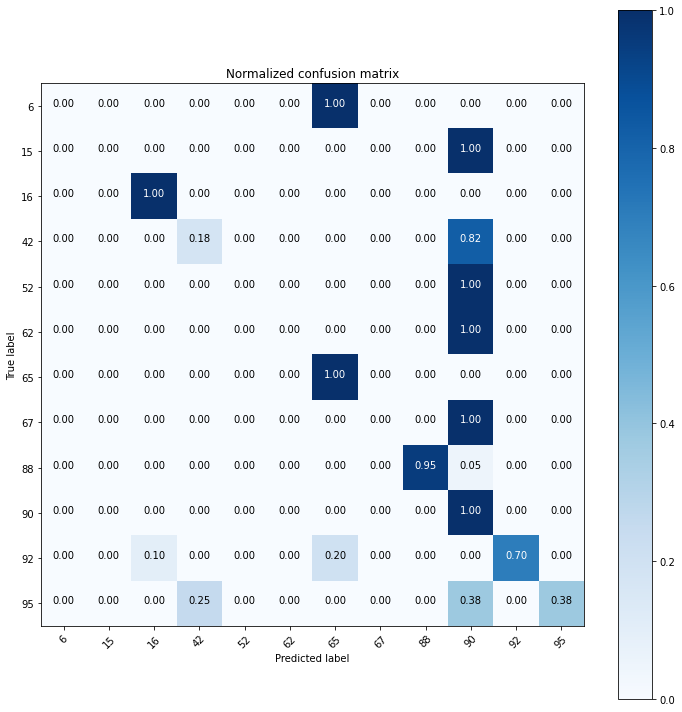

In [50]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, "%.2f"%cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)


    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Compute confusion matrix
cnf_matrix = confusion_matrix(y_testddf, clfddf.predict(X_testddf))
np.set_printoptions(precision=2)

# Plot normalized confusion matrix
plt.figure(figsize=(10,10))
np.set_printoptions(precision=2)
plot_confusion_matrix(cnf_matrix, classes=["%d"%i for i in np.unique(y_testddf)], normalize=True,
                      title='Normalized confusion matrix')

plt.show()

Figure: The present figure shows the accuracies of the model through a confusion matrix. This matrix plots the proportion of correctly classifieed observations vs. incorrectly classified observations. Many observations were misclassified as 90 as demonstrated by the darker blue squares. This is consistent with results from homework 7, however, it does seem like adding the encoded features increased the number of correctly classified observations by improving features that were incorrectly classified in the previous homework (HW7).